# Installing necessary libraries

In [1]:
!pip install -q xplique

import os
import cv2
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

%matplotlib inline
%config InlineBackend.figure_format='retina'

import xplique
from xplique.plots import plot_attributions

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 191.4/191.4 kB 3.9 MB/s eta 0:00:00


# Downloadind and loading Patchcam images

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
IMAGES_PATH ="drive/MyDrive/camelyonpatch_level_2_split_valid_x.h5"
LABELS_PATH ="drive/MyDrive/camelyonpatch_level_2_split_valid_y.h5"

In [4]:
import tensorflow as tf
import os

In [5]:
import h5py
images = np.array(h5py.File(IMAGES_PATH)['x'][:100])
labels = np.array([y.item() for y in h5py.File(LABELS_PATH)['y'][:100]])

**Filter and resize the images to fit the model**

In [ ]:
images_filtered = images[labels == 1] #Only malignant images
resized_images = tf.image.resize(images_filtered, (224, 224))

fig, axes = plt.subplots(1, 5, figsize=(15, 5))
for i in range(5):
    img = resized_images[i].numpy()
    if np.isnan(img).any() or np.isinf(img).any():
        print(f"Warning: Image {i} contains NaN or Inf values. Skipping...")
        continue
    axes[i].imshow(img/255.0)
    axes[i].set_title('Label: {}'.format(labels[i]))
    axes[i].axis('off')
plt.show()

# Prepare the model, images and labels

In [8]:
import tensorflow.keras.applications as app

model, preprocessing = app.MobileNetV2(), app.mobilenet_v2.preprocess_input

X = preprocessing(np.array(resized_images, copy=True))
Y = tf.one_hot([1] * len(X), 1000) # class 1 is malignant

14536120/14536120 [==============================] - 0s 0us/step


# Generate explanations




/usr/local/lib/python3.10/dist-packages/xplique/attributions/lime.py:129: UserWarning: You set a number of perturbed samples per input >= 500 and batch_size is set to NoneThis mean that you will ask your model to handle more than 500 perturbed samples per input at once.This can lead to OOM issue. To avoid it you can set the batch_size argument.
  warnings.warn(


Method: Saliency


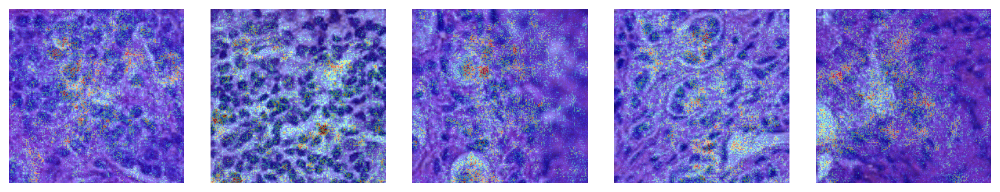



Method: GradientInput


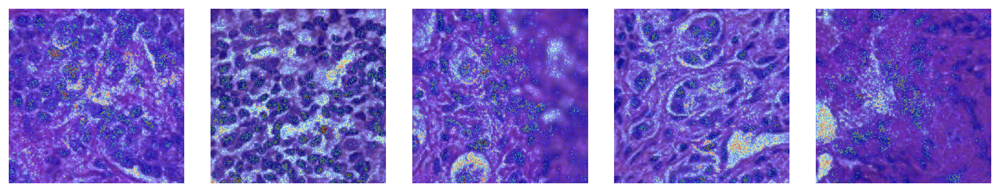

Method: GuidedBackprop


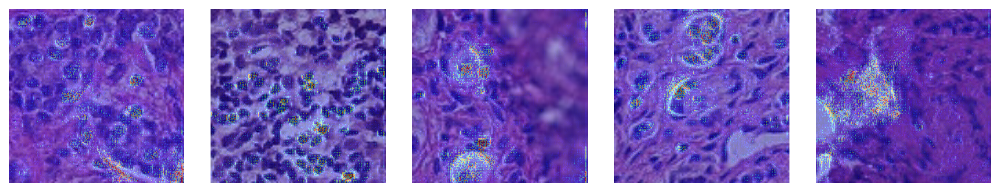

Method: IntegratedGradients


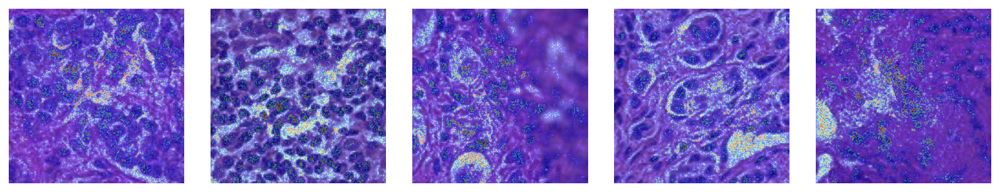



Method: SmoothGrad


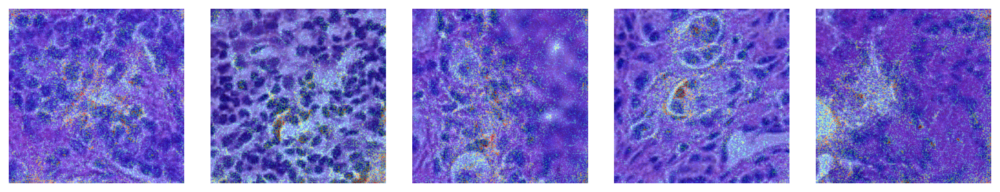



Method: SquareGrad


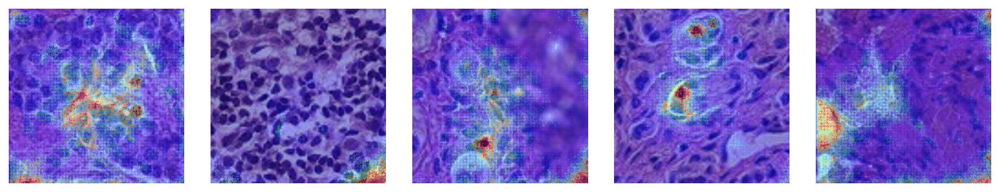



Method: VarGrad


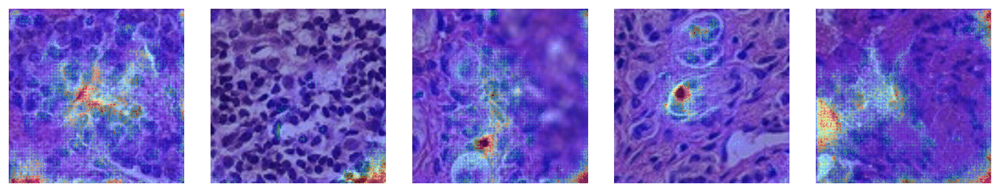



Method: GradCAM


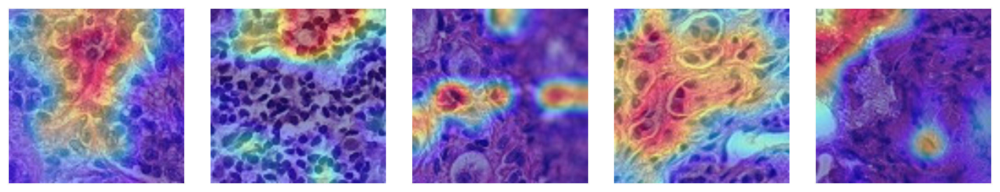



Method: GradCAMPP


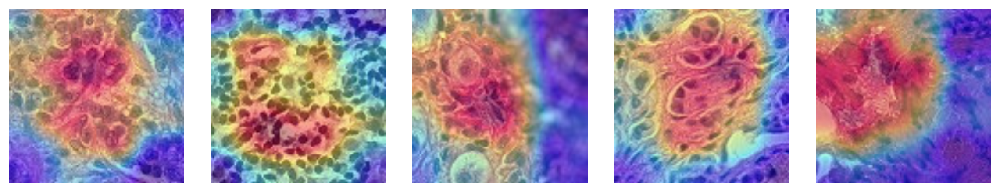



Method: Occlusion


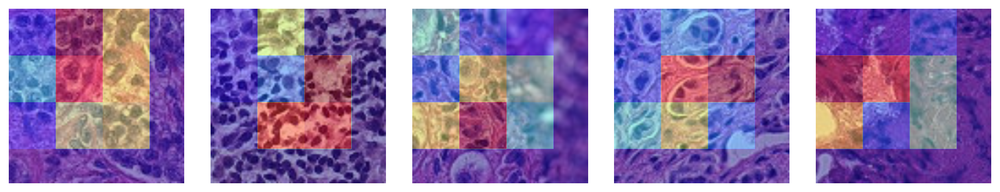



Method: Rise


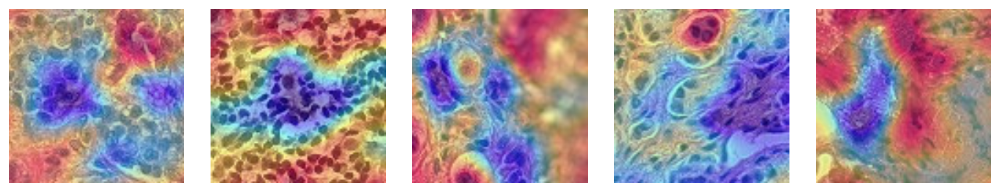



Method: Lime


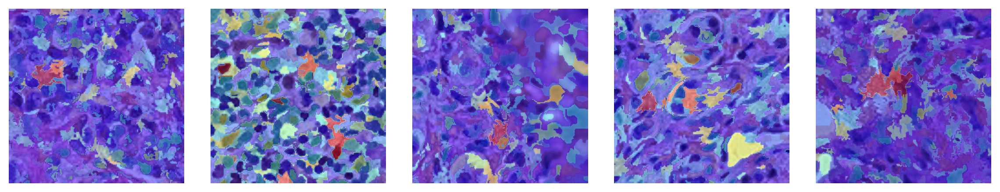



Method: KernelShap


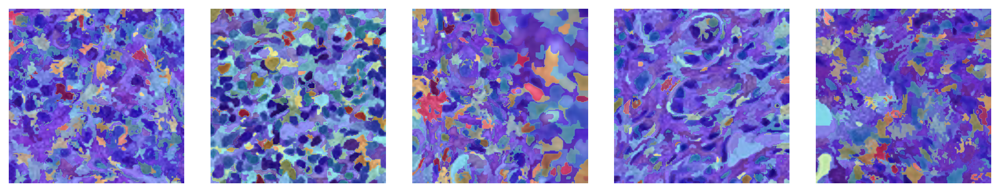

In [9]:
from xplique.attributions import (Saliency, GradientInput, IntegratedGradients, SmoothGrad, VarGrad,
                                  SquareGrad, GradCAM, Occlusion, Rise, GuidedBackprop,
                                  GradCAMPP, Lime, KernelShap)

# to explain the logits is to explain the class,
# to explain the softmax is to explain why this class rather than another
# it is therefore recommended to explain the logit
model.layers[-1].activation = tf.keras.activations.linear
batch_size = 64

explainers = [
             Saliency(model),
             GradientInput(model),
             GuidedBackprop(model),
             IntegratedGradients(model, steps=50, batch_size=batch_size),
             SmoothGrad(model, nb_samples=50, batch_size=batch_size),
             SquareGrad(model, nb_samples=50, batch_size=batch_size),
             VarGrad(model, nb_samples=50, batch_size=batch_size),
             GradCAM(model),
             GradCAMPP(model),
             Occlusion(model, patch_size=60, patch_stride=60, batch_size=batch_size),
              Rise(model, nb_samples=4000, batch_size=batch_size),
              Lime(model, nb_samples = 1000),
              KernelShap(model, nb_samples = 1000)
]

explanations_to_test = {}

for explainer in explainers:

  explainer_name = explainer.__class__.__name__
  explanations = explainer(X, Y).numpy()

  if len(explanations.shape) > 3:
    explanations = np.mean(explanations, -1)

  # store the explanations to use the metrics
  explanations_to_test[explainer_name] = explanations

  print(f"Method: {explainer_name}")
  plot_attributions(explanations[:5], X[:5], cmap='jet', alpha=0.4,
                    cols=5, clip_percentile=0.5, absolute_value=True)
  plt.show()
  print("\n")

#   Calculate metrics

In [10]:
%load_ext google.colab.data_table
import pandas as pd

**Deletion Metric**

In [11]:
from xplique.metrics import Deletion

metric = Deletion(model, X, Y, batch_size)
deletion_scores = []

i = 0
for explanation_name, explanations in explanations_to_test.items():
  deletion_score = metric(explanations)
  deletion_scores.append((explanation_name, deletion_score))

pd.DataFrame(deletion_scores, columns=["Method name", "Deletion score (lower is better)"])

,Method name,Deletion score (lower is better)
0,Saliency,0.576119
1,GradientInput,0.162795
2,GuidedBackprop,-0.023689
3,IntegratedGradients,0.013597
4,SmoothGrad,0.553128
5,SquareGrad,0.696307
6,VarGrad,0.709081
7,GradCAM,0.058503
8,GradCAMPP,0.224613
9,Occlusion,-0.540020


**Insertion Metric**

In [12]:
from xplique.metrics import Insertion

metric = Insertion(model, X, Y, batch_size)
insertion_scores = []

i = 0
for explanation_name, explanations in explanations_to_test.items():
  insertion_score = metric(explanations)
  insertion_scores.append((explanation_name, insertion_score))

pd.DataFrame(insertion_scores, columns=["Method name", "Insertion score (higher is better)"])

,Method name,Insertion score (higher is better)
0,Saliency,0.637156
1,GradientInput,0.483311
2,GuidedBackprop,0.369164
3,IntegratedGradients,0.680757
4,SmoothGrad,1.003814
5,SquareGrad,0.199646
6,VarGrad,0.254551
7,GradCAM,0.399468
8,GradCAMPP,0.411462
9,Occlusion,-0.162700


**MuFidelity Metric**


In [13]:
from xplique.metrics import MuFidelity

metric = MuFidelity(model, X, Y, batch_size, nb_samples=25)
fidelity_scores = []

i = 0
for explanation_name, explanations in explanations_to_test.items():
  fidelity_score = metric(explanations)
  fidelity_scores.append((explanation_name, fidelity_score))

pd.DataFrame(fidelity_scores, columns=["Method name", "Fidelity score (higher is better)"])

,Method name,Fidelity score (higher is better)
0,Saliency,-0.021538
1,GradientInput,0.065305
2,GuidedBackprop,0.044593
3,IntegratedGradients,0.095554
4,SmoothGrad,-0.076018
5,SquareGrad,-0.053982
6,VarGrad,-0.058077
7,GradCAM,0.022443
8,GradCAMPP,-0.057274
9,Occlusion,-0.014310


**Stability Metric**

In [14]:
from xplique.metrics import AverageStability

metric = AverageStability(model, X[:20], Y[:20], batch_size, nb_samples=32)
stability_scores = []

i = 0
for explainer in explainers:
  explainer_name = explainer.__class__.__name__
  stability_score = metric(explainer)
  stability_scores.append((explainer_name, stability_score))

pd.DataFrame(stability_scores, columns=["Method name", "Stability score (lower is better)"])

,Method name,Stability score (lower is better)
0,Saliency,4.150637e+00
1,GradientInput,1.435872e+00
2,GuidedBackprop,2.422828e-01
3,IntegratedGradients,9.900709e-01
4,SmoothGrad,3.616346e-01
5,SquareGrad,1.708842e-02
6,VarGrad,1.554915e-02
7,GradCAM,3.078805e+00
8,GradCAMPP,3.555624e+00
9,Occlusion,5.504332e+01
